In [65]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy as sc
import seaborn as sns
import sklearn.metrics
import sklearn
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
import datetime as dt
import pylab

In [3]:
data = pd.read_csv(r'live_supply_chain_data.csv')

In [4]:
data

,Foundation,SKU-1002,22.21,Pre-Order,2,103.61,Adult,4,7,74,...,USA,1554,12,1188.12,Pass,0.0425,Road,Route-27,7726.14,2024-06-12
0,Lipstick,SKU-1020,83.16,Pre-Order,9,1413.07,Teen,208,5,70,...,China,7310,2,1444.19,Pass,0.0463,Air,Route-10,2835.18,2024-06-12
1,Blush,SKU-1040,27.80,Pre-Order,14,527.67,Teen,236,2,17,...,India,6621,28,3920.17,Fail,0.0079,Sea,Route-35,7841.40,2024-06-12
2,Blush,SKU-1020,83.16,Pre-Order,17,1674.62,Senior,410,3,41,...,China,712,5,1775.02,Pass,0.0027,Air,Route-3,4580.94,2024-06-12
3,Lipstick,SKU-1020,83.16,Pre-Order,11,2257.90,Teen,63,6,94,...,Mexico,5948,2,3190.57,Fail,0.0345,Air,Route-27,7262.75,2024-06-12
4,Blush,SKU-1002,22.21,Out of Stock,8,199.18,Adult,177,1,19,...,USA,7325,4,4088.54,Fail,0.0111,Air,Route-23,4213.75,2024-06-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35994,Foundation,SKU-1022,68.05,Pre-Order,23,2880.96,Senior,337,9,66,...,Mexico,4335,5,1165.38,Pass,0.0411,Sea,Route-29,9906.31,2024-06-23
35995,Mascara,SKU-1047,95.61,In Stock,30,2396.64,Senior,212,10,32,...,Mexico,6154,5,3452.86,Pass,0.0905,Road,Route-18,6671.34,2024-06-23
35996,Eyeliner,SKU-1040,27.80,Out of Stock,33,870.55,Senior,366,1,45,...,Mexico,9876,27,3737.62,Pass,0.0013,Air,Route-22,4044.36,2024-06-23
35997,Foundation,SKU-1012,22.79,Out of Stock,20,785.29,Teen,104,14,97,...,Germany,5245,3,1154.50,Pass,0.0172,Road,Route-27,4995.28,2024-06-23


In [5]:

column_names = [
    'Product Type', 'SKU', 'Price', 'Availability', 'Number of products sold',
    'Revenue generated', 'Customer demographics', 'Stock levels', 'Lead times',
    'Order quantities', 'Shipping times', 'Shipping carriers', 'Shipping costs',
    'Supplier name', 'Location', 'Production volumes', 'Manufacturing lead time',
    'Manufacturing costs', 'Inspection results', 'Defect rates', 'Transportation modes',
    'Routes', 'Costs', 'Timestamp'
]

file_path = 'live_supply_chain_data.csv'
data = pd.read_csv(file_path, header=None)

data.columns = column_names

data.to_csv('data.csv', index=False)

In [31]:
data = pd.read_csv(r'live_supply_chain_data.csv')

In [32]:
import pandas as pd
df = pd.read_csv('data.csv')

data = df.head(10000)

data.to_csv('trimmed_dataset.csv', index=False)

data.head()


,Product Type,SKU,Price,Availability,Number of products sold,Revenue generated,Customer demographics,Stock levels,Lead times,Order quantities,...,Location,Production volumes,Manufacturing lead time,Manufacturing costs,Inspection results,Defect rates,Transportation modes,Routes,Costs,Timestamp
0,Foundation,SKU-1002,22.21,Pre-Order,2,103.61,Adult,4,7,74,...,USA,1554,12,1188.12,Pass,0.0425,Road,Route-27,7726.14,2024-06-12
1,Lipstick,SKU-1020,83.16,Pre-Order,9,1413.07,Teen,208,5,70,...,China,7310,2,1444.19,Pass,0.0463,Air,Route-10,2835.18,2024-06-12
2,Blush,SKU-1040,27.80,Pre-Order,14,527.67,Teen,236,2,17,...,India,6621,28,3920.17,Fail,0.0079,Sea,Route-35,7841.40,2024-06-12
3,Blush,SKU-1020,83.16,Pre-Order,17,1674.62,Senior,410,3,41,...,China,712,5,1775.02,Pass,0.0027,Air,Route-3,4580.94,2024-06-12
4,Lipstick,SKU-1020,83.16,Pre-Order,11,2257.90,Teen,63,6,94,...,Mexico,5948,2,3190.57,Fail,0.0345,Air,Route-27,7262.75,2024-06-12


In [33]:
data.shape

(10000, 24)

In [34]:
print(data.columns)

Index(['Product Type', 'SKU', 'Price', 'Availability',
       'Number of products sold', 'Revenue generated', 'Customer demographics',
       'Stock levels', 'Lead times', 'Order quantities', 'Shipping times',
       'Shipping carriers', 'Shipping costs', 'Supplier name', 'Location',
       'Production volumes', 'Manufacturing lead time', 'Manufacturing costs',
       'Inspection results', 'Defect rates', 'Transportation modes', 'Routes',
       'Costs', 'Timestamp'],
      dtype='object')


In [35]:
data.head()

,Product Type,SKU,Price,Availability,Number of products sold,Revenue generated,Customer demographics,Stock levels,Lead times,Order quantities,...,Location,Production volumes,Manufacturing lead time,Manufacturing costs,Inspection results,Defect rates,Transportation modes,Routes,Costs,Timestamp
0,Foundation,SKU-1002,22.21,Pre-Order,2,103.61,Adult,4,7,74,...,USA,1554,12,1188.12,Pass,0.0425,Road,Route-27,7726.14,2024-06-12
1,Lipstick,SKU-1020,83.16,Pre-Order,9,1413.07,Teen,208,5,70,...,China,7310,2,1444.19,Pass,0.0463,Air,Route-10,2835.18,2024-06-12
2,Blush,SKU-1040,27.80,Pre-Order,14,527.67,Teen,236,2,17,...,India,6621,28,3920.17,Fail,0.0079,Sea,Route-35,7841.40,2024-06-12
3,Blush,SKU-1020,83.16,Pre-Order,17,1674.62,Senior,410,3,41,...,China,712,5,1775.02,Pass,0.0027,Air,Route-3,4580.94,2024-06-12
4,Lipstick,SKU-1020,83.16,Pre-Order,11,2257.90,Teen,63,6,94,...,Mexico,5948,2,3190.57,Fail,0.0345,Air,Route-27,7262.75,2024-06-12


In [36]:
import plotly.express as px


fig = px.scatter(
    data,
    x='Price',
    y='Revenue generated',
    color='Product Type',
    hover_data=[
        'Number of products sold',
        'Availability',
        'Customer demographics'
    ],
    trendline="ols"
)

fig.show()


In [46]:
import plotly.express as px


product_sales_data = data.groupby('Product Type')['Number of products sold'].sum().reset_index()


pie_chart = px.pie(
    product_sales_data,
    values='Number of products sold',
    names='Product Type',
    title='Sales Distribution by Product Type',
    hover_data=['Number of products sold'],
    hole=0.5,
    color_discrete_sequence=px.colors.qualitative.Pastel
)


pie_chart.update_traces(
    textposition='inside',
    textinfo='percent+label'
)


pie_chart.show()


In [47]:
import plotly.graph_objects as go


total_revenue = data.groupby('Shipping carriers')['Revenue generated'].sum().reset_index()


fig = go.Figure()


fig.add_trace(go.Bar(
    x=total_revenue['Shipping carriers'],
    y=total_revenue['Revenue generated'],
    marker_color='lightblue'
))


fig.update_traces(text=total_revenue['Revenue generated'], textposition='auto')


fig.update_layout(
    title='Total Revenue by Shipping Carrier',
    xaxis_title='Shipping Carrier',
    yaxis_title='Revenue Generated',
    template='plotly_white'
)


fig.show()


In [48]:
import plotly.express as px

grouped_data = data.groupby(['Product Type', 'SKU'], as_index=False)['Revenue generated'].sum()
revenue_chart = px.line(
    grouped_data,
    x='SKU',
    y='Revenue generated',
    color='Product Type',
    title='Revenue Generated by SKU Under Each Product Type',
    markers=True
)


revenue_chart.update_layout(
    xaxis_title='SKU',
    yaxis_title='Revenue Generated',
    template='plotly_white'
)

revenue_chart.show()


In [49]:
import plotly.express as px


grouped_stock_data = data.groupby(['Product Type', 'SKU'], as_index=False)['Stock levels'].sum()


stock_chart = px.line(
    grouped_stock_data,
    x='SKU',
    y='Stock levels',
    color='Product Type',
    title='Stock Levels by SKU Under Each Product Type',
    markers=True
)

stock_chart.update_layout(
    xaxis_title='SKU',
    yaxis_title='Stock Levels',
    template='plotly_white'
)


stock_chart.show()


In [50]:
import plotly.express as px


grouped_order_data = data.groupby(['Product Type', 'SKU'], as_index=False)['Order quantities'].sum()

order_quantity_chart = px.bar(
    grouped_order_data,
    x='SKU',
    y='Order quantities',
    color='Product Type',
    title='Order Quantity by SKU Under Each Product Type',
    barmode='group'
)

order_quantity_chart.update_layout(
    xaxis_title='SKU',
    yaxis_title='Order Quantities',
    template='plotly_white'
)

order_quantity_chart.show()


In [51]:
import plotly.express as px


grouped_shipping_data = data.groupby(['Shipping carriers'], as_index=False)['Shipping costs'].sum()


shipping_cost_chart = px.bar(
    grouped_shipping_data,
    x='Shipping carriers',
    y='Shipping costs',
    title='Shipping Costs by Carrier',
    color='Shipping carriers'
)
shipping_cost_chart.update_layout(
    xaxis_title='Shipping Carrier',
    yaxis_title='Shipping Costs',
    template='plotly_white'
)

shipping_cost_chart.show()

In [52]:
import plotly.express as px


grouped_transportation_data = data.groupby('Transportation modes', as_index=False)['Costs'].sum()


transportation_chart = px.pie(
    grouped_transportation_data,
    values='Costs',
    names='Transportation modes',
    title='Cost Distribution by Transportation Mode',
    hole=0.5,
    color_discrete_sequence=px.colors.qualitative.Pastel
)


transportation_chart.update_traces(textposition='inside', textinfo='percent+label')


transportation_chart.show()


In [53]:
import plotly.express as px


defect_rates_by_product = data.groupby('Product Type')['Defect rates'].mean().reset_index()


pie_chart = px.pie(
    defect_rates_by_product,
    values='Defect rates',
    names='Product Type',
    title='Average Defect Rates by Product Type',
    hole=0.5,
    color_discrete_sequence=px.colors.qualitative.Pastel
)


pie_chart.update_traces(textposition='inside', textinfo='percent+label')


pie_chart.show()


In [54]:
import pandas as pd
import plotly.express as px


pivot_table = pd.pivot_table(data, values='Defect rates',
                             index=['Transportation modes'],
                             aggfunc='mean')


transportation_chart = px.pie(
    values=pivot_table["Defect rates"],
    names=pivot_table.index,
    title='Defect Rates by Transportation Mode',
    hole=0.5,
    color_discrete_sequence=px.colors.qualitative.Pastel
)


transportation_chart.update_traces(textposition='inside', textinfo='percent+label')

transportation_chart.update_layout(
    xaxis_title='Transportation Mode',
    yaxis_title='Defect Rates',
    template='plotly_white'
)

transportation_chart.show()


C:\Users\kat92\AppData\Local\Temp\ipykernel_14524\1551594744.py:8: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

14:41:29 - cmdstanpy - INFO - Chain [1] start processing
14:41:29 - cmdstanpy - INFO - Chain [1] done processing
c:\Users\kat92\AppData\Local\Programs\Python\Python311\Lib\site-packages\prophet\forecaster.py:1854: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



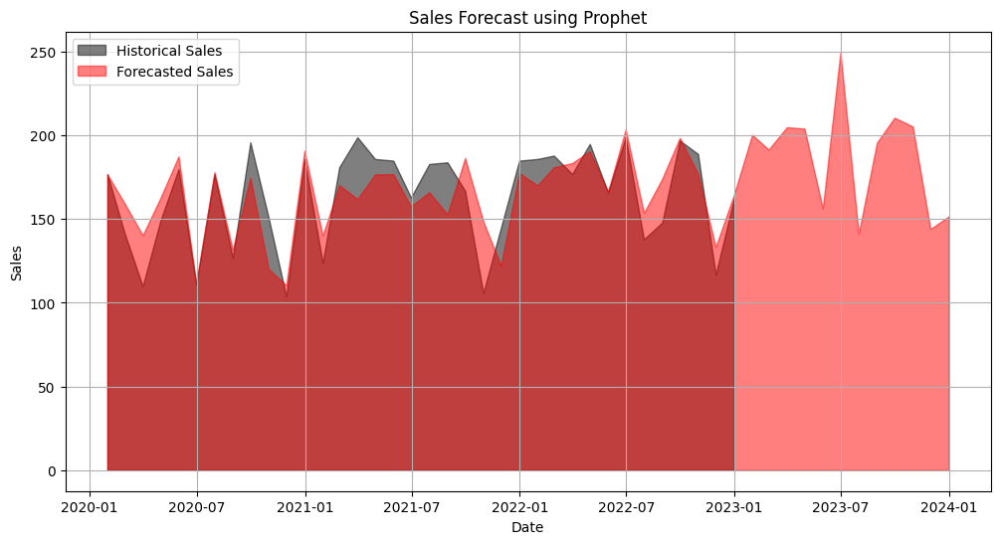

In [55]:
import pandas as pd
import numpy as np
from prophet import Prophet
import matplotlib.pyplot as plt


sales_data = pd.DataFrame({
    'Date': pd.date_range(start='2020-01-01', periods=36, freq='M'),
    'Sales': np.random.randint(100, 200, size=36)
})

prophet_data = sales_data.rename(columns={'Date': 'ds', 'Sales': 'y'})
prophet_data['ds'] = pd.to_datetime(prophet_data['ds'])

model = Prophet()
model.fit(prophet_data)

future = model.make_future_dataframe(periods=12, freq='M')
forecast = model.predict(future)


plt.figure(figsize=(12, 6))


plt.fill_between(prophet_data['ds'], prophet_data['y'], color='black', alpha=0.5, label='Historical Sales')


plt.fill_between(forecast['ds'], forecast['yhat'], color='red', alpha=0.5, label='Forecasted Sales')


plt.title('Sales Forecast using Prophet')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.grid()


plt.show()


14:05:09 - cmdstanpy - INFO - Chain [1] start processing
14:05:09 - cmdstanpy - INFO - Chain [1] done processing
c:\Users\kat92\AppData\Local\Programs\Python\Python311\Lib\site-packages\prophet\forecaster.py:1854: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



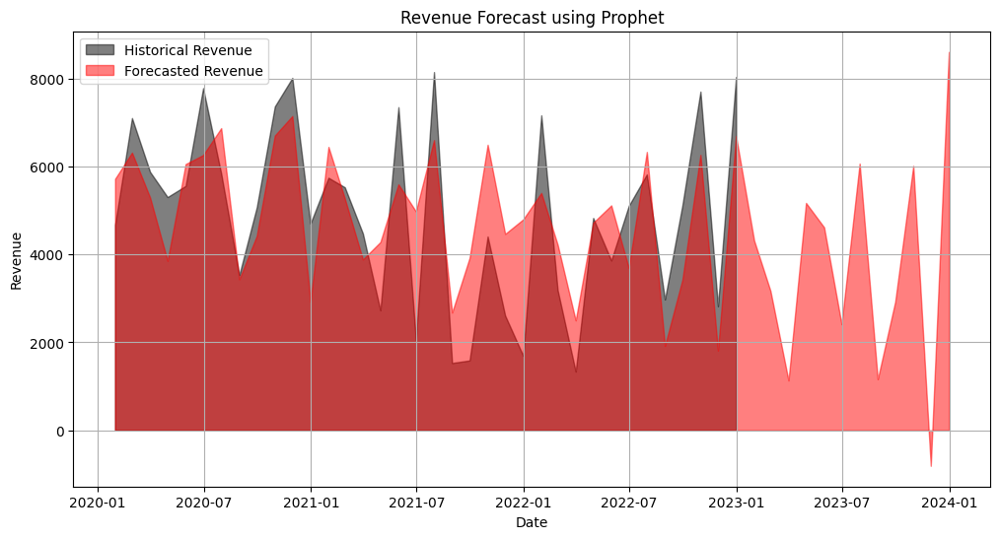

In [22]:
import pandas as pd
import numpy as np
from prophet import Prophet
import matplotlib.pyplot as plt


data = pd.DataFrame({
    'Date': pd.date_range(start='2020-01-01', periods=36, freq='ME'),
    'Sales': np.random.randint(100, 200, size=36),
    'Price': np.random.uniform(10, 50, size=36)
})

data['Revenue'] = data['Sales'] * data['Price']

prophet_data = data.reset_index()[['Date', 'Revenue']]
prophet_data['Date'] = pd.to_datetime(prophet_data['Date']).dt.date
prophet_data.columns = ['ds', 'y']


model = Prophet()
model.fit(prophet_data)


future = model.make_future_dataframe(periods=12, freq='M')
forecast = model.predict(future)


plt.figure(figsize=(12, 6))


plt.fill_between(prophet_data['ds'], prophet_data['y'], color='black', alpha=0.5, label='Historical Revenue')

plt.fill_between(forecast['ds'], forecast['yhat'], color='red', alpha=0.5, label='Forecasted Revenue')

plt.title('Revenue Forecast using Prophet')
plt.xlabel('Date')
plt.ylabel('Revenue')
plt.legend(loc='upper left')
plt.grid()

plt.show()


In [56]:
import sklearn.preprocessing


le =  sklearn.preprocessing.LabelEncoder()

In [80]:
data['Product type']= le.fit_transform(data['Product Type'])#convert the categorical columns into numeric
data['Customer demographics']= le.fit_transform(data['Customer demographics'])
data['Shipping carriers']= le.fit_transform(data['Shipping carriers'])
data['Location']= le.fit_transform(data['Location'])
data['SKU']= le.fit_transform(data['SKU'])
data['Inspection results']= le.fit_transform(data['Inspection results'])
data['Transportation modes']= le.fit_transform(data['Transportation modes'])
data['Routes']= le.fit_transform(data['Routes'])
data['Supplier name']= le.fit_transform(data['Supplier name'])

C:\Users\kat92\AppData\Local\Temp\ipykernel_14524\3062118645.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\kat92\AppData\Local\Temp\ipykernel_14524\3062118645.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\kat92\AppData\Local\Temp\ipykernel_14524\3062118645.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

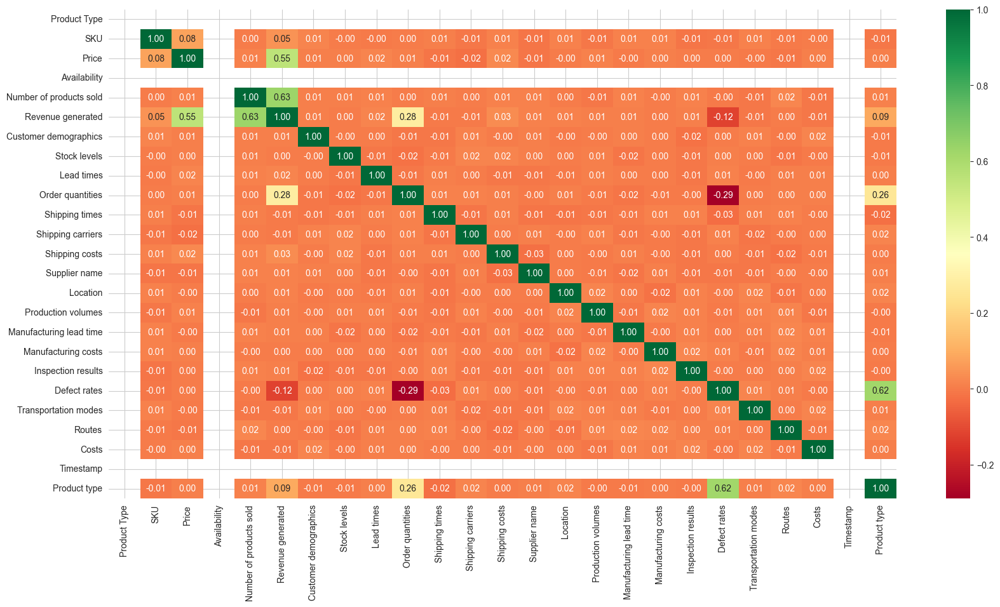

In [72]:
# Select only numeric columns for correlation
data_features = data[[ 
    'Product Type','Price', 'Availability', 'Number of products sold',
    'Revenue generated','Customer demographics', 'Inspection results', 'Production volumes','Routes', 'Stock levels', 'Lead times',
    'Order quantities', 'Shipping times', 'Shipping costs',
    'Production volumes', 'Manufacturing lead time',
    'Manufacturing costs', 'Defect rates', 'Costs'
]]


data_features = data.apply(pd.to_numeric, errors='coerce')

# Now create the heatmap using only the numeric features
fig = plt.figure(figsize=(20,10))
sns.heatmap(data_features.corr(), annot=True, fmt='.2f', cmap='RdYlGn')

plt.show()

In [66]:
%matplotlib inline
pylab.rcParams['figure.figsize']=5,4
sns.set_style('whitegrid')

In [73]:
DT =  data[['Product Type','Price', 'Number of products sold',
    'Revenue generated','Customer demographics', 'Stock levels', 'Lead times',
    'Order quantities', 'Shipping times', 'Shipping costs', 'Location',
    'Production volumes', 'Manufacturing lead time','Inspection results', 'Routes', 'Transportation modes',
    'Manufacturing costs', 'Defect rates', 'Costs']]

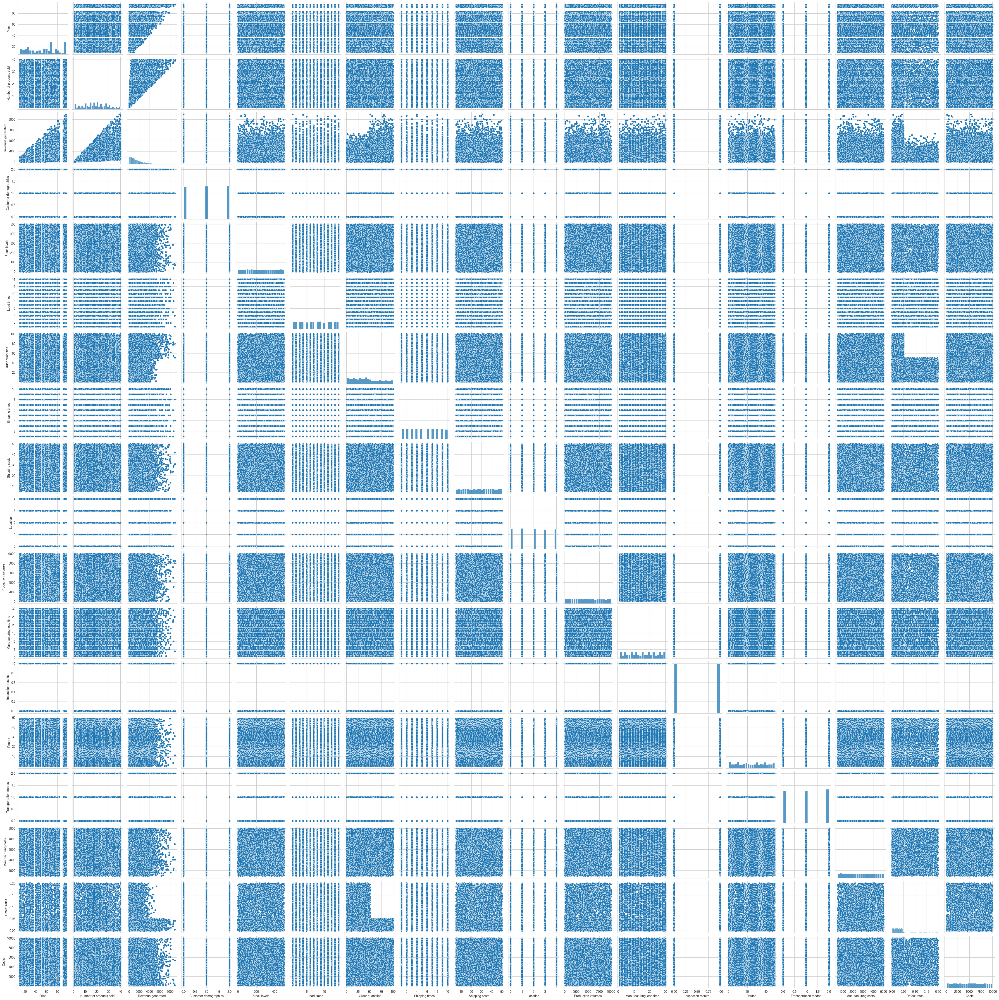

In [74]:
sns.pairplot(DT)

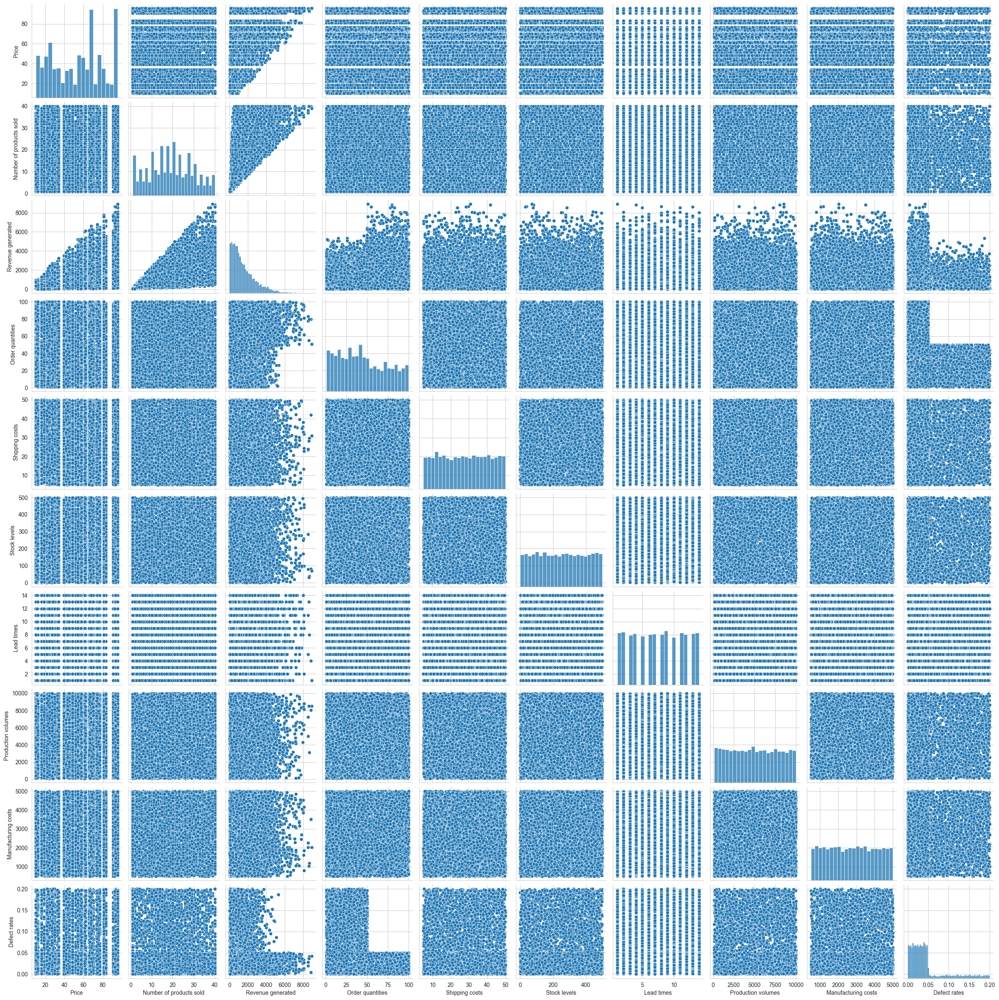

In [75]:
Stock = data[['Price', 'Number of products sold','Revenue generated',
               'Order quantities', 'Shipping costs', 'Stock levels',
                 'Lead times', 'Production volumes', 'Manufacturing costs',
                   'Defect rates']]
sns.pairplot(Stock)

In [78]:
stock = data[['Product Type', 'Price', 'Number of products sold','Revenue generated','Customer demographics',
               'Order quantities','Shipping times','Location', 'Shipping costs', 'Stock levels', 
                 'Lead times', 'Production volumes', 'Manufacturing costs', 'Manufacturing lead time', 'Inspection results',
                   'Defect rates', 'Transportation modes', 'Routes', 'Costs']]